<a href="https://colab.research.google.com/github/cchang-vassar/Semantic-Relations-in-Vector-Embeddings/blob/main/study4_pca_nomic.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# [Nomic] Current Embeddings of Arguments vs. Counterarguments

## Imports

In [85]:
import os
import re
import subprocess
import zipfile
import shutil
import numpy as np
import pandas as pd
from google.colab import userdata
from enum import Enum
from typing import Optional
from ctypes import Union
from pathlib import Path
import torch

## OSF Setup

In [73]:
!pip install osfclient

In [74]:
import osfclient.cli

In [75]:
from osfclient.api import OSF
from osfclient.models import Project, Storage
from io import BytesIO

In [76]:
os.environ["OSF_USERNAME"] = userdata.get("OSF_USERNAME")
OSF_USERNAME = os.environ["OSF_USERNAME"]

In [77]:
os.environ["OSF_PASSWORD"] = userdata.get("OSF_PASSWORD")
OSF_PASSWORD = os.environ["OSF_PASSWORD"]

In [78]:
os.environ["OSF_TOKEN"] = userdata.get("OSF_TOKEN")
OSF_TOKEN = os.environ["OSF_TOKEN"]

In [79]:
os.environ["OSF_PROJECT_ID"] = userdata.get("OSF_PROJECT_ID")
OSF_PROJECT_ID = os.environ["OSF_PROJECT_ID"]

## Nomic Setup

In [ ]:
!pip install nomic

In [ ]:
!pip install sentence_transformers

In [ ]:
!pip install einops

In [ ]:
import nomic
from sentence_transformers import SentenceTransformer

## Class Declarations

In [55]:
# Enum for categories
class TaskType(Enum):
  SEARCH_DOCUMENT = "sd"
  SEARCH_QUERY = "sq"
  CLUSTERING = "clu"
  CLASSIFICATION = "cla"

## Grab data from OSF

In [56]:
subprocess.run("osf -p sakjg fetch --force osfstorage/arguments_dump.zip", shell=True)
print("arguments_dump.zip successfully imported")

arguments_dump_file_path_zip = '/content/arguments_dump.zip'
arguments_dump_file_path = '/content/current_data_dump/arguments_dump'
with zipfile.ZipFile(arguments_dump_file_path_zip, 'r') as zip_ref:
  zip_ref.extractall(arguments_dump_file_path)

extracted_files = os.listdir(arguments_dump_file_path)
print("Files extracted:", extracted_files)

arguments_dump.zip successfully imported
Files extracted: ['economy', 'global_arguments.pkl', 'environment', 'culture', 'sport', 'law', 'science', 'health', 'digital-freedoms', 'free-speech-debate', 'politics', 'society', 'international', 'education', 'religion', 'philosophy']


## Load Arguments df

In [57]:
arguments_data_path = "current_data_dump/arguments_dump/"
loaded_economy_debate_arguments_df = pd.read_pickle(f"{arguments_data_path}economy/business_economy_general_house_would_prohibit_retailers_selling_certain_items_arguments.pkl")
loaded_economy_category_arguments_df = pd.read_pickle(f"{arguments_data_path}economy/economy_arguments.pkl")
loaded_global_arguments_df = pd.read_pickle(f"{arguments_data_path}global_arguments.pkl")

## Import Embeddings Dump

In [58]:
subprocess.run("osf -p sakjg fetch --force osfstorage/nomic_embeddings_dump.zip", shell=True)
print("nomic_embeddings_dump.zip successfully imported")

nomic_embeddings_dump_file_path_zip = '/content/nomic_embeddings_dump.zip'
nomic_embeddings_dump_file_path = '/content/current_data_dump/nomic_embeddings_dump'
with zipfile.ZipFile(nomic_embeddings_dump_file_path_zip, 'r') as zip_ref:
  zip_ref.extractall(nomic_embeddings_dump_file_path)

extracted_files = os.listdir(nomic_embeddings_dump_file_path)
print("Files extracted:", extracted_files)

nomic_embeddings_dump.zip successfully imported
Files extracted: ['__MACOSX', 'nomic_embeddings_dump']


## Get Embeddings

In [29]:
DIM_EMBEDDING = 768
model = SentenceTransformer("nomic-ai/nomic-embed-text-v1", trust_remote_code=True)

def _get_embeddings(arguments_df: pd.DataFrame) -> pd.DataFrame:
  arguments_list = list(arguments_df['argument'])

  search_document_embeddings = model.encode(['search_document: ' + argument for argument in arguments_list])
  search_document_df = pd.DataFrame(search_document_embeddings, columns=[f"search_document_{str(i)}" for i in range(DIM_EMBEDDING)])
  embeddings_sd_df = pd.concat([arguments_df, search_document_df], axis=1)

  search_query_embeddings = model.encode(['search_query: ' + argument for argument in arguments_list])
  search_query_df = pd.DataFrame(search_query_embeddings, columns=[f"search_query_{str(i)}" for i in range(DIM_EMBEDDING)])
  embeddings_sq_df = pd.concat([arguments_df, search_query_df], axis=1)

  clustering_embeddings = model.encode(['clustering: ' + argument for argument in arguments_list])
  clustering_df = pd.DataFrame(clustering_embeddings, columns=[f"clustering_{str(i)}" for i in range(DIM_EMBEDDING)])
  embeddings_clu_df = pd.concat([arguments_df, clustering_df], axis=1)

  classification_embeddings = model.encode(['classification: ' + argument for argument in arguments_list])
  classification_df = pd.DataFrame(classification_embeddings, columns=[f"classification_{str(i)}" for i in range(DIM_EMBEDDING)])
  embeddings_cla_df = pd.concat([arguments_df, classification_df], axis=1)

  output_folder = f'current_data_dump/nomic_embeddings_dump/'
  if not os.path.exists(output_folder):
    os.makedirs(output_folder)
  sd_output_file_path = f'{output_folder}global_sd_embeddings.pkl'
  sq_output_file_path = f'{output_folder}global_sq_embeddings.pkl'
  clu_output_file_path = f'{output_folder}global_clu_embeddings.pkl'
  cla_output_file_path = f'{output_folder}global_cla_embeddings.pkl'

  embeddings_sd_df.to_pickle(sd_output_file_path)
  embeddings_sq_df.to_pickle(sq_output_file_path)
  embeddings_clu_df.to_pickle(clu_output_file_path)
  embeddings_cla_df.to_pickle(cla_output_file_path)

  return {
    "embeddings_sd_df": embeddings_sd_df,
    "embeddings_sq_df": embeddings_sq_df,
    "embeddings_clu_df": embeddings_clu_df,
    "embeddings_cla_df": embeddings_cla_df
  }

pytorch_model.bin:   0%|          | 0.00/547M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.19k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/270 [00:00<?, ?B/s]

In [30]:
embeddings_df = _get_embeddings(loaded_global_arguments_df)

KeyboardInterrupt: 

## Export Embeddings Dump

In [35]:
embeddings_dump_file_path = '/content/current_data_dump/nomic_embeddings_dump'
embeddings_dump_file_path_zip = '/content/current_data_dump/nomic_embeddings_dump'
shutil.make_archive(embeddings_dump_file_path_zip, 'zip', embeddings_dump_file_path)
print(f"Zip file created at: {embeddings_dump_file_path_zip}")
result = subprocess.run([f"osf -p sakjg upload --force {embeddings_dump_file_path_zip}.zip nomic_embeddings_dump.zip"], shell=True, capture_output=True, text=True)
print(result.stderr)
print(f"File: {embeddings_dump_file_path_zip} uploaded at osfstorage")

Zip file created at: /content/current_data_dump/nomic_embeddings_dump

File: /content/current_data_dump/nomic_embeddings_dump uploaded at osfstorage


## Load Embeddings

In [59]:
embeddings_data_path = "current_data_dump/nomic_embeddings_dump/nomic_embeddings_dump/"
loaded_global_embeddings_sd_df = pd.read_pickle(f"{embeddings_data_path}global_sd_embeddings.pkl")
loaded_global_embeddings_sq_df = pd.read_pickle(f"{embeddings_data_path}global_sq_embeddings.pkl")
loaded_global_embeddings_clu_df = pd.read_pickle(f"{embeddings_data_path}global_clu_embeddings.pkl")
loaded_global_embeddings_cla_df = pd.read_pickle(f"{embeddings_data_path}global_cla_embeddings.pkl")

## Analyze Nomic Embeddings

In [60]:
import joblib
from sklearn.decomposition import PCA

In [61]:
def _analysis_write_to_file(analysis_data: pd.DataFrame, pca: PCA, task_type: TaskType):
  """Write analysis results to pickle file"""
  output_folder = f'current_data_dump/nomic_pca_dump/'
  output_file_path = f'{output_folder}global_{task_type.value}_pca.pkl'
  pca_file_path = f'{output_folder}global_{task_type.value}_pca_obj.pkl'

  os.makedirs(output_folder, exist_ok=True)
  analysis_data.to_pickle(output_file_path)
  joblib.dump(pca, pca_file_path)

In [62]:
def _pca_normalization(pair_df: pd.DataFrame) -> pd.DataFrame:
  """Normalize PCA argument embeddings from a df"""
  ret_df = pd.DataFrame()

  point_row = pair_df[pair_df['type'] == 'point']
  counter_row = pair_df[pair_df['type'] == 'counter']

  point_nonnum_row = point_row.select_dtypes(exclude=[np.number])
  counter_nonnum_row = counter_row.select_dtypes(exclude=[np.number])
  new_nonnum_rows = pd.concat([point_nonnum_row, counter_nonnum_row])
  new_nonnum_rows = new_nonnum_rows.reset_index(drop=True)

  point_vec = point_row.select_dtypes(include=[np.number]).values.flatten()
  counter_vec = counter_row.select_dtypes(include=[np.number]).values.flatten()

  center = (point_vec.copy() + counter_vec.copy()) / 2
  point_vec -= center
  counter_vec -= center
  point_vec = point_vec.flatten()
  counter_vec = counter_vec.flatten()

  point_new_num_row = pd.DataFrame(point_vec.reshape(1,-1), columns=['{}'.format(i) for i in range(len(point_vec))])
  counter_new_num_row = pd.DataFrame(counter_vec.reshape(1,-1), columns=['{}'.format(i) for i in range(len(counter_vec))])
  new_num_rows = pd.concat([point_new_num_row, counter_new_num_row])
  new_num_rows = new_num_rows.reset_index(drop=True)
  return new_nonnum_rows.join(new_num_rows)

In [63]:
def _pca_preprocessing(embeddings_df: pd.DataFrame) -> pd.DataFrame:
  if len(embeddings_df) % 2 != 0:
    print("Warning: embeddings_df not in pairs")
  embeddings_ret_df = pd.DataFrame()
  topics = list(embeddings_df['topic'].unique())

  for topic in topics:
    topic_rows = embeddings_df[embeddings_df['topic'] == topic]
    if len(topic_rows) % 2 != 0:
      print(f"Warning: Topic '{topic}' has {len(topic_rows)} rows.")
    pair_ids = list(topic_rows['pair_id'].unique())

    for pair_id in pair_ids:
      pair_df = topic_rows[topic_rows['pair_id'] == pair_id]
      if len(pair_df) != 2:
        print(f"Warning: Pair {pair_id} at topic '{topic}' has {len(pair_df)} rows.")
        continue
      embeddings_ret_df = pd.concat([embeddings_ret_df, _pca_normalization(pair_df)])
      embeddings_ret_df = embeddings_ret_df.reset_index(drop=True)
  return embeddings_ret_df

In [64]:
def pca_embeddings(
    embeddings_df: pd.DataFrame,
    num_components: int,
    task_type: TaskType
  ):
  embeddings_processed = _pca_preprocessing(embeddings_df)
  numeric_columns = embeddings_processed.select_dtypes(include=[np.number]).columns
  non_numeric_columns = embeddings_processed.select_dtypes(exclude=[np.number]).columns
  embeddings_data = embeddings_processed[numeric_columns].values

  num_components = min(num_components, embeddings_data.shape[0], embeddings_data.shape[1])
  pca = PCA(n_components=num_components)
  embeddings_pca = pca.fit_transform(embeddings_data)
  embeddings_pca_data = (
    pd.DataFrame(embeddings_pca, columns=['pca_{}'.format(i) for i in range(num_components)])
    .join(embeddings_processed[non_numeric_columns].reset_index(drop=True))
  )

  # Printing PCA attributes
  components = pca.components_
  explained_variance = pca.explained_variance_
  explained_variance_ratio = pca.explained_variance_ratio_
  singular_values = pca.singular_values_
  mean_value = pca.mean_
  n_components = pca.n_components_
  n_features = pca.n_features_in_
  n_samples = pca.n_samples_

  # Displaying the attributes
  print("Components:")
  print(components)
  print("\nExplained Variance:")
  print(explained_variance)
  print("\nExplained Variance Ratio:")
  print(explained_variance_ratio)
  print("\nSingular Values:")
  print(singular_values)
  print("\nMean:")
  print(mean_value)
  print("\nNumber of Components:")
  print(n_components)
  print("\nNumber of Features:")
  print(n_features)
  print("\nNumber of Samples:")
  print(n_samples)

  # Write to file
  _analysis_write_to_file(embeddings_pca_data, pca, task_type)
  return embeddings_pca_data

### Import PCA Dump

In [89]:
subprocess.run("osf -p sakjg fetch --force osfstorage/nomic_pca_dump.zip", shell=True)
print("nomic_pca_dump.zip successfully imported")

nomic_pca_dump_file_path_zip = 'nomic_pca_dump.zip'
nomic_pca_dump_file_path = 'current_data_dump/nomic_pca_dump/nomic_pca_dump'
with zipfile.ZipFile(nomic_pca_dump_file_path_zip, 'r') as zip_ref:
  zip_ref.extractall(nomic_pca_dump_file_path)

extracted_files = os.listdir(nomic_pca_dump_file_path)
print("Files extracted:", extracted_files)

nomic_pca_dump.zip successfully imported
Files extracted: ['global_clu_pca_obj.pkl', 'nomic_pca_dump.zip', 'global_cla_pca_obj.pkl', 'global_clu_pca.pkl', 'global_sq_pca.pkl', 'global_sd_pca_obj.pkl', 'global_sq_pca_obj.pkl', 'global_sd_pca.pkl', 'global_cla_pca.pkl']


### Analyze Embeddings

In [65]:
global_sd_pca = pca_embeddings(loaded_global_embeddings_sd_df, 10, TaskType.SEARCH_DOCUMENT)

Components:
[[ 1.85211981e-03 -3.22748125e-02 -2.16384847e-02 ... -1.38213777e-03
   1.57266427e-02 -5.68583235e-03]
 [-2.30077375e-02 -2.39969715e-02  9.49236332e-04 ... -2.43032109e-02
  -1.41982045e-02  1.07138120e-02]
 [-1.79025438e-02 -2.48551406e-02  1.63911365e-03 ...  6.73438981e-02
  -1.31557919e-02  2.03461535e-02]
 ...
 [-1.59093905e-02 -1.87587719e-02 -1.32371485e-02 ...  3.50426100e-02
  -3.39195319e-02  3.52289192e-02]
 [-5.20876572e-02  9.14965123e-02  3.16820331e-02 ... -6.33886978e-02
   1.68677568e-02  2.83772638e-03]
 [ 3.47015858e-02 -5.76708429e-02  1.26445775e-05 ...  2.87600309e-02
  -5.21766879e-02  4.77188043e-02]]

Explained Variance:
[0.00262362 0.00177351 0.00133946 0.00121532 0.00111878 0.00098837
 0.00093357 0.00091628 0.00088261 0.00087066]

Explained Variance Ratio:
[0.02564895 0.01733816 0.01309481 0.01188121 0.01093736 0.00966247
 0.00912679 0.00895771 0.00862859 0.00851173]

Singular Values:
[4.5540857 3.7442763 3.2539887 3.0995364 2.973875  2.795185 

In [66]:
global_sq_pca = pca_embeddings(loaded_global_embeddings_sq_df, 10, TaskType.SEARCH_QUERY)

Components:
[[-0.04541466 -0.05066591 -0.02477563 ...  0.00214186  0.00100507
  -0.04056663]
 [-0.00099929 -0.01336136  0.0075814  ... -0.01856323 -0.04052196
   0.03461372]
 [-0.00639014  0.00655113  0.0152428  ... -0.07897059  0.00887744
  -0.03823444]
 ...
 [ 0.00478511  0.04444605  0.01673316 ... -0.03430289 -0.01139838
  -0.07176606]
 [-0.01298785  0.01647665 -0.02147355 ... -0.04373426  0.03105755
   0.05199081]
 [-0.0323682   0.06513467  0.00807562 ... -0.0877929   0.08837493
  -0.03085548]]

Explained Variance:
[0.00327823 0.00191982 0.00154136 0.00127189 0.00117855 0.00112191
 0.0010625  0.00099958 0.00099433 0.00097288]

Explained Variance Ratio:
[0.0276517  0.01619356 0.01300129 0.01072829 0.00994101 0.00946325
 0.00896216 0.00843141 0.00838711 0.00820615]

Singular Values:
[5.090623  3.8956618 3.4906256 3.1708474 3.0522869 2.9780369 2.89812
 2.810995  2.803601  2.7731912]

Mean:
[-1.00129551e-12 -1.84356159e-11 -6.56732004e-12  6.00777284e-12
  4.19366104e-11 -2.44728387e-1

In [67]:
global_clu_pca = pca_embeddings(loaded_global_embeddings_clu_df, 10, TaskType.CLUSTERING)

Components:
[[-0.04417932 -0.02236674  0.00869343 ...  0.0077957   0.02092985
  -0.02652214]
 [ 0.0022097  -0.0014976  -0.00161078 ... -0.00298035  0.03868521
  -0.05162401]
 [-0.00159008  0.00192222 -0.03115478 ...  0.07517736 -0.01147776
   0.03889659]
 ...
 [ 0.01013542  0.03251375  0.00210464 ... -0.074191    0.00829776
  -0.0357197 ]
 [-0.03615111  0.00907831 -0.00539279 ...  0.10249416 -0.02598105
  -0.02097232]
 [-0.01085554 -0.01202185 -0.00792611 ...  0.02880984 -0.03528406
   0.04693704]]

Explained Variance:
[0.0026029  0.00168998 0.00154167 0.00115664 0.00112153 0.00099017
 0.00098008 0.00090713 0.00089396 0.00088719]

Explained Variance Ratio:
[0.0284018  0.01844042 0.01682206 0.01262075 0.01223765 0.01080429
 0.01069427 0.00989825 0.00975458 0.00968071]

Singular Values:
[4.536068  3.6550386 3.4909706 3.0237734 2.9775267 2.7977233 2.7834415
 2.677847  2.6583426 2.648258 ]

Mean:
[-3.18058566e-11 -4.41747992e-11  1.23689438e-12 -1.62857765e-11
 -5.97243296e-11  8.06926314e

In [68]:
global_cla_pca = pca_embeddings(loaded_global_embeddings_cla_df, 10, TaskType.CLASSIFICATION)

Components:
[[-0.01473345 -0.00644878  0.01173593 ... -0.00415135 -0.01049467
  -0.00026434]
 [-0.02191261  0.00889393  0.00400505 ... -0.00339694  0.02248832
  -0.05934785]
 [-0.01414882  0.00684078 -0.04546069 ...  0.06741611 -0.01027003
   0.05481408]
 ...
 [-0.04362106  0.01743615  0.00295092 ...  0.12111474 -0.02899556
  -0.01548125]
 [-0.02225175 -0.05196238 -0.00866558 ...  0.06653894  0.00567497
   0.04142455]
 [ 0.10227364 -0.06198571  0.00911881 ... -0.0547538   0.04049719
  -0.00973025]]

Explained Variance:
[0.00477876 0.00379241 0.00202238 0.00146271 0.00131357 0.0011963
 0.00115696 0.00113436 0.00111296 0.00103842]

Explained Variance Ratio:
[0.04840464 0.03841376 0.0204849  0.01481601 0.01330528 0.01211751
 0.01171897 0.01149012 0.01127335 0.01051829]

Singular Values:
[6.1462264 5.4753075 3.9983609 3.4004054 3.2223825 3.0751886 3.024195
 2.994521  2.96614   2.8650854]

Mean:
[-8.83495967e-13 -5.20673643e-11  5.21262634e-12 -2.30003464e-11
 -1.15443479e-11  2.40310914e-1

### Export PCA Dump

In [71]:
nomic_pca_dump_file_path = '/content/current_data_dump/nomic_pca_dump'
nomic_pca_dump_file_path_zip = '/content/current_data_dump/nomic_pca_dump/nomic_pca_dump'
shutil.make_archive(nomic_pca_dump_file_path_zip, 'zip', nomic_pca_dump_file_path)
print(f"Zip file created at: {nomic_pca_dump_file_path_zip}")
result = subprocess.run([f"osf -p sakjg upload --force {nomic_pca_dump_file_path_zip}.zip nomic_pca_dump.zip"], shell=True, capture_output=True, text=True)
print(result.stderr)
print(f"File: {nomic_pca_dump_file_path_zip} uploaded at osfstorage")

Zip file created at: /content/current_data_dump/nomic_pca_dump/nomic_pca_dump

File: /content/current_data_dump/nomic_pca_dump/nomic_pca_dump uploaded at osfstorage


## Plot Embeddings

### [Imports] Analysis Plot

In [92]:
from plotnine import ggplot, geom_point, geom_text, geom_bar, geom_line, geom_histogram, aes, scale_x_continuous, theme, theme_void, labs, element_text, facet_wrap, ggsave

### Import Plots Dump

In [84]:
subprocess.run("osf -p sakjg fetch --force osfstorage/nomic_pca_plots_dump.zip", shell=True)
print("nomic_pca_plots_dump.zip successfully imported")

nomic_pca_plots_dump_file_path_zip = 'nomic_pca_plots_dump.zip'
nomic_pca_plots_dump_file_path = 'current_data_dump/nomic_pca_plots_dump'
with zipfile.ZipFile(nomic_pca_plots_dump_file_path_zip, 'r') as zip_ref:
  zip_ref.extractall(nomic_pca_plots_dump_file_path)

extracted_files = os.listdir(nomic_pca_plots_dump_file_path)
print("Files extracted:", extracted_files)

nomic_pca_plots_dump.zip successfully imported
Files extracted: ['__MACOSX', 'nomic_pca_plots_dump']


### Function for Plotting Embeddings PCA

In [86]:
def _insert_line_breaks(text, max_width=50):
  words = text.split(' ')
  lines = []
  current_line = ''

  for word in words:
    if len(current_line) + len(word) <= max_width:
      current_line += word + ' '
    else:
      lines.append(current_line.strip())
      current_line = word + ' '

  lines.append(current_line.strip())
  return '\n'.join(lines)

In [87]:
def global_plot(global_plot_data: pd.DataFrame, task_type: TaskType):
  """Plot embeddings for all debates"""
  global_plot_data['interaction'] = global_plot_data['pair_id'] + '_' + global_plot_data['topic']
  gg = (
    ggplot(global_plot_data, aes(x='x', y='y', group='interaction')) +
    geom_line(color='black', size=0.2, alpha=0.8) +
    geom_line(color='red', size=0.5, data=global_plot_data[global_plot_data['topic'] == 'business-economic-policy-economy-general-house-believes-national-minimum-wage']) +
    geom_point(color='red', data=global_plot_data[global_plot_data['type'] == 'point'][global_plot_data['topic'] == 'business-economic-policy-economy-general-house-believes-national-minimum-wage']) +
    labs(
      title=f'PCA Plot for All Debates',
      x=f'PCA_x',
      y=f'PCA_y'
    ) +
    theme(
      legend_position="none",
      plot_title=element_text(size=40, wrap=True),
      strip_text=element_text(angle=0, hjust=0.5, vjust=1, wrap=True),
      axis_text=element_text(size=24),
      axis_title=element_text(size=32),
      figure_size=(16, 16)
    )
  )

  # Save to file
  output_folder = f'current_data_dump/nomic_pca_plots_dump/nomic_pca_plots_dump/global-view/'
  output_file_path = f'{output_folder}global_{task_type.value}_pca_plot.png'
  os.makedirs(output_folder, exist_ok=True)
  ggsave(gg, output_file_path)
  print(gg)

### Load PCA df

In [90]:
# Global level
pca_data_path = "current_data_dump/nomic_pca_dump/nomic_pca_dump/"
loaded_global_sd_pca_df = pd.read_pickle(f"{pca_data_path}global_sd_pca.pkl")
loaded_global_sq_pca_df = pd.read_pickle(f"{pca_data_path}global_sq_pca.pkl")
loaded_global_clu_pca_df = pd.read_pickle(f"{pca_data_path}global_clu_pca.pkl")
loaded_global_cla_pca_df = pd.read_pickle(f"{pca_data_path}global_cla_pca.pkl")

### Plot Embeddings PCA

<ipython-input-87-21777baa76af>:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.10/dist-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.10/dist-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: current_data_dump/nomic_pca_plots_dump/nomic_pca_plots_dump/global-view/global_sd_pca_plot.png


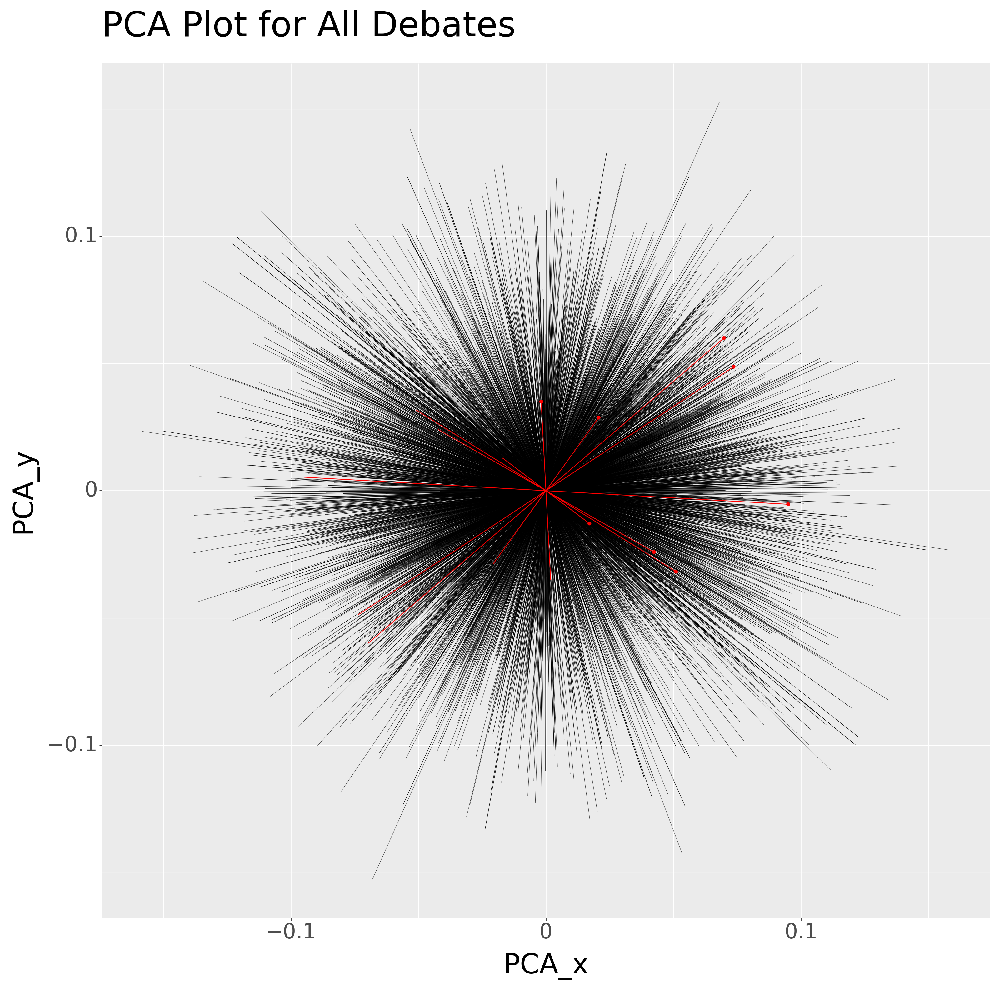

In [93]:
global_sd_pca_plot_df = loaded_global_sd_pca_df.copy()
global_sd_pca_plot_df['x'] = global_sd_pca_plot_df['pca_0']
global_sd_pca_plot_df['y'] = global_sd_pca_plot_df['pca_1']
global_plot(global_sd_pca_plot_df, TaskType.SEARCH_DOCUMENT)

/var/folders/2n/62zj90f973l3dbhpl1jl3qvw0000gn/T/ipykernel_22399/2458118698.py:9: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global-view/global_sq_pca_plot.png


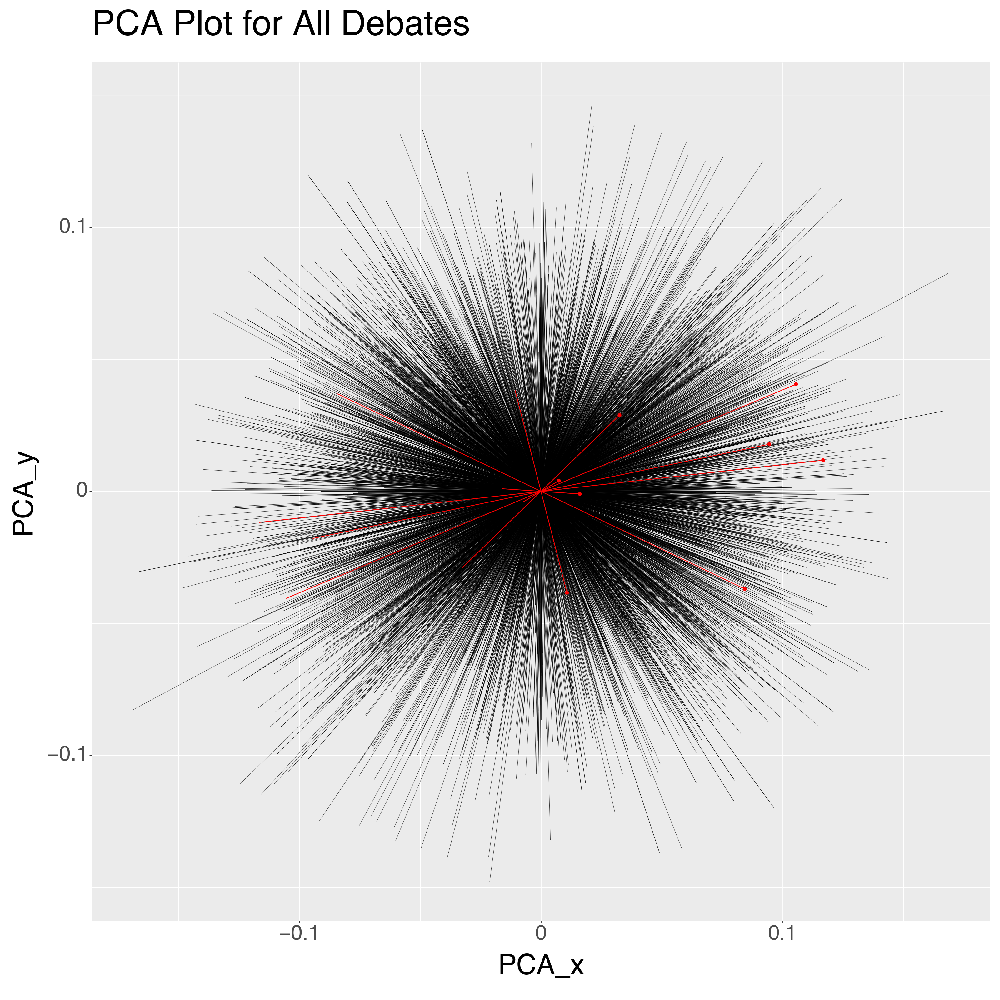

In [ ]:
global_sq_pca_plot_df = loaded_global_sq_pca_df.copy()
global_sq_pca_plot_df['x'] = global_sq_pca_plot_df['pca_0']
global_sq_pca_plot_df['y'] = global_sq_pca_plot_df['pca_1']
global_plot(global_sq_pca_plot_df, TaskType.SEARCH_QUERY)

/var/folders/2n/62zj90f973l3dbhpl1jl3qvw0000gn/T/ipykernel_22399/2458118698.py:9: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global-view/global_clu_pca_plot.png


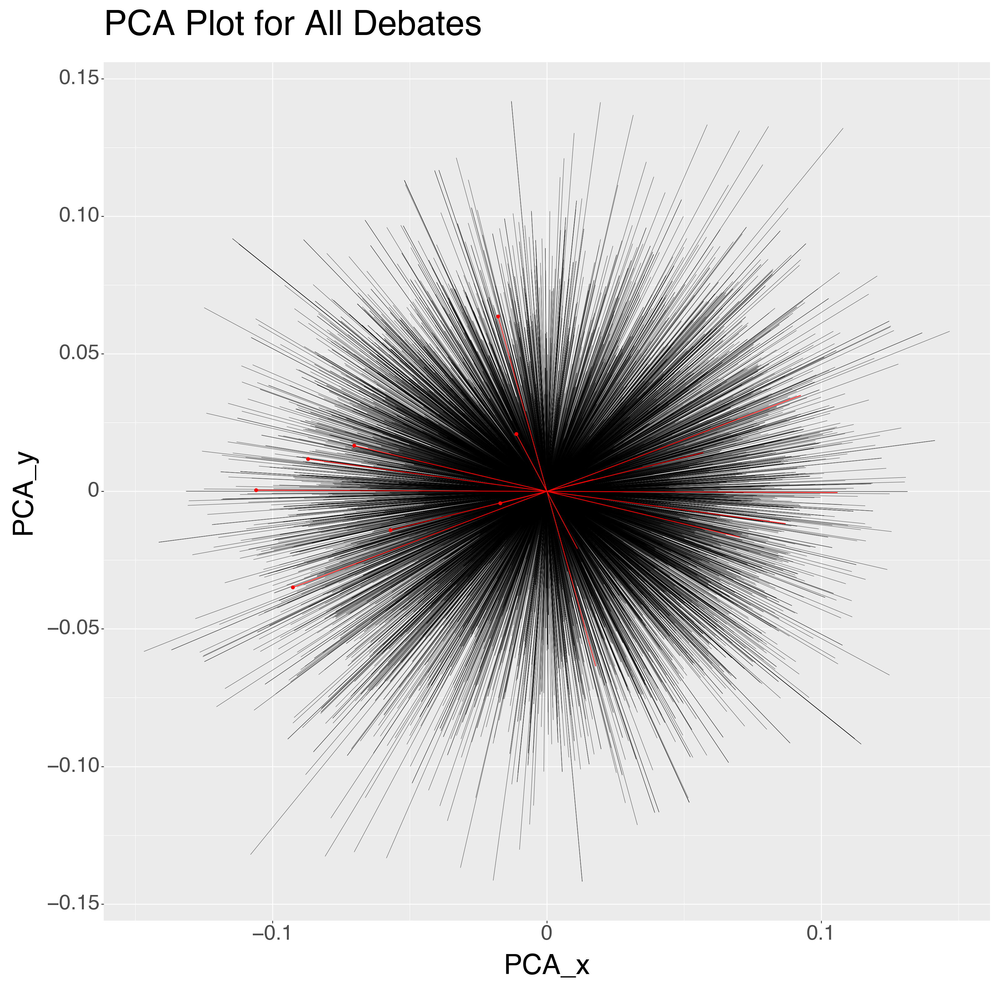

In [ ]:
global_clu_pca_plot_df = loaded_global_clu_pca_df.copy()
global_clu_pca_plot_df['x'] = global_clu_pca_plot_df['pca_0']
global_clu_pca_plot_df['y'] = global_clu_pca_plot_df['pca_1']
global_plot(global_clu_pca_plot_df, TaskType.CLUSTERING)

/var/folders/2n/62zj90f973l3dbhpl1jl3qvw0000gn/T/ipykernel_22399/2458118698.py:9: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global-view/global_cla_pca_plot.png


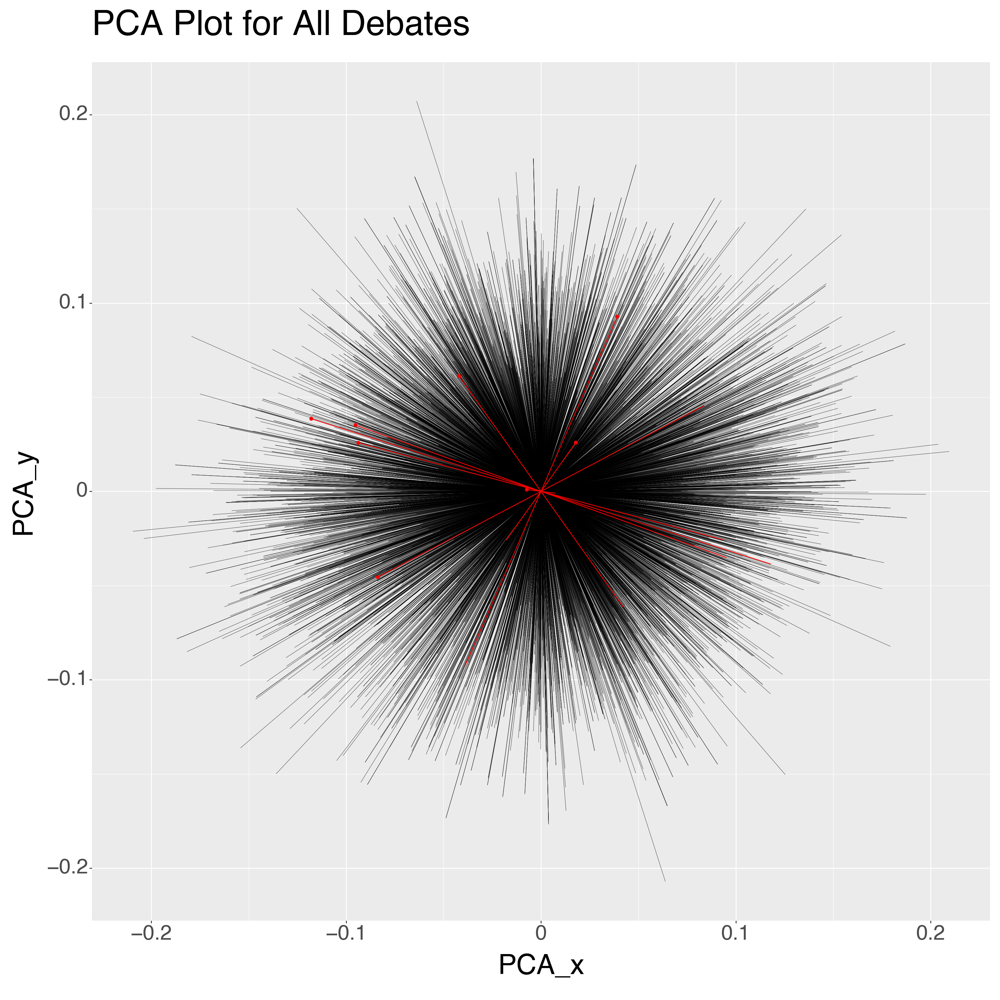

In [ ]:
global_cla_pca_plot_df = loaded_global_cla_pca_df.copy()
global_cla_pca_plot_df['x'] = global_cla_pca_plot_df['pca_0']
global_cla_pca_plot_df['y'] = global_cla_pca_plot_df['pca_1']
global_plot(global_cla_pca_plot_df, TaskType.CLASSIFICATION)

### Function for Plotting PCA Object

In [94]:
def global_pca_object_plot(pca_object: PCA, task_type: TaskType):
  pca_obj = pca_object.explained_variance_ratio_
  pca_obj_df = pd.DataFrame({'pca_explained_ratio': pca_obj})
  pca_obj_df['pca_num'] = pca_obj_df.index + 1

  gg = (
    ggplot(pca_obj_df, aes(x='pca_num', y='pca_explained_ratio')) +
    geom_bar(stat="identity") +
    labs(
      title=f'Ratio of Explained Variance for Principal Components 1 to 10'
      ) +
    theme(
      axis_title=element_text(size=32),
      axis_text=element_text(size=24),
      plot_title=element_text(size=36, wrap=True, lineheight=1.5),
      strip_text=element_text(angle=0, hjust=0.5, vjust=1, wrap=True),
      figure_size=(16, 16)
    ) +
    scale_x_continuous(breaks=list(range(int(pca_obj_df['pca_num'].min()), int(pca_obj_df['pca_num'].max()) + 1)))
  )

  ggsave(gg, f"../data_dump/nomic_pca_plots_dump/nomic_pca_plots_dump/global_{task_type.value}_pca_components_plot.png")
  print(gg)

### Load PCA Object

In [ ]:
pca_object_folder_path = "current_data_dump/nomic_pca_dump/nomic_pca_dump/"
loaded_global_sd_pca_obj = joblib.load(f"{pca_object_folder_path}global_sd_pca_obj.pkl")
loaded_global_sq_pca_obj = joblib.load(f"{pca_object_folder_path}global_sq_pca_obj.pkl")
loaded_global_clu_pca_obj = joblib.load(f"{pca_object_folder_path}global_clu_pca_obj.pkl")
loaded_global_cla_pca_obj = joblib.load(f"{pca_object_folder_path}global_cla_pca_obj.pkl")

### Plot PCA Objects

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global_sd_pca_components_plot.png


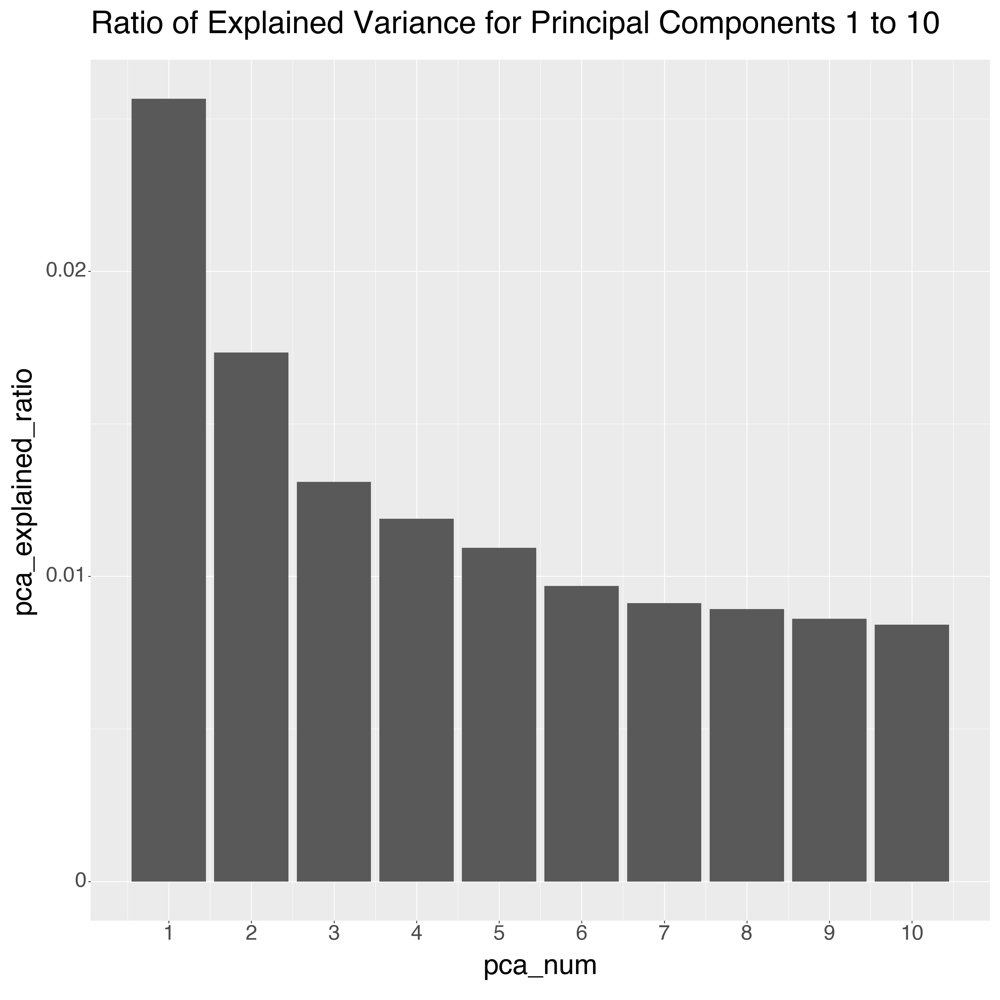

In [ ]:
global_pca_object_plot(loaded_global_sd_pca_obj, TaskType.SEARCH_DOCUMENT)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global_sq_pca_components_plot.png


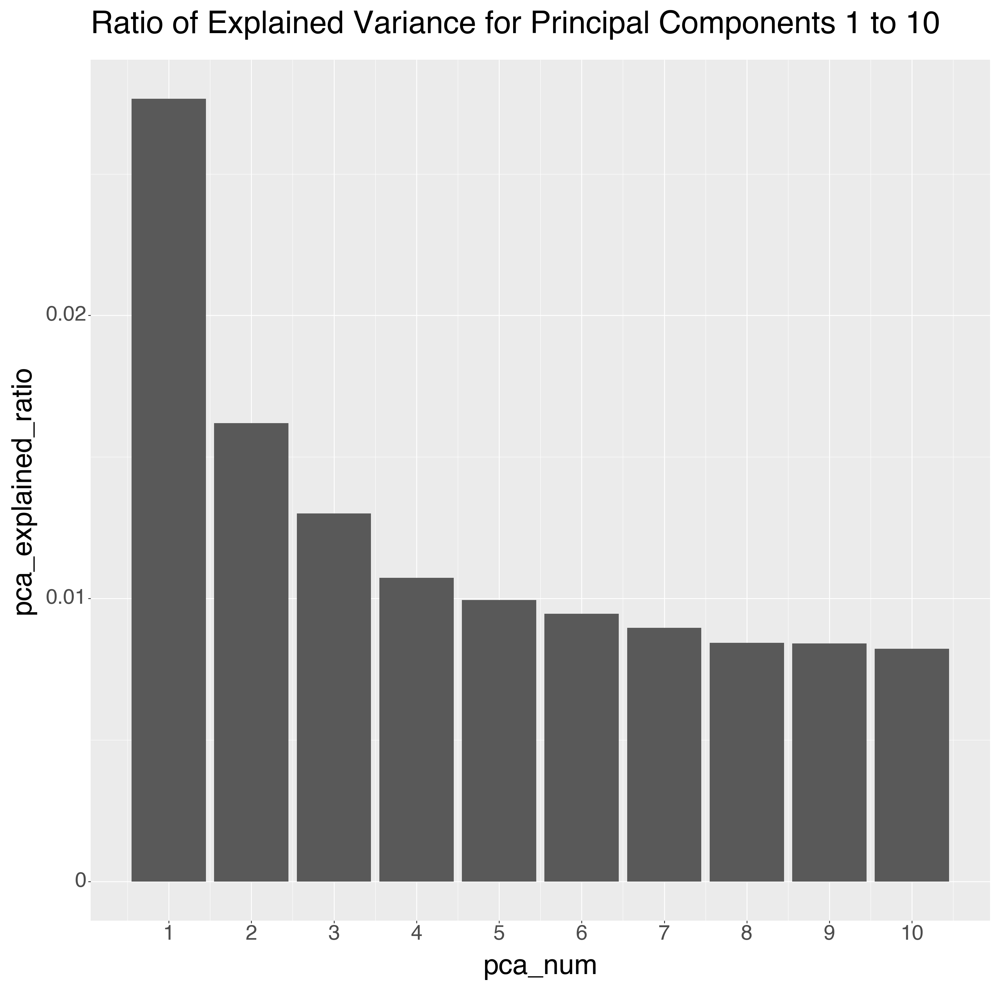

In [ ]:
global_pca_object_plot(loaded_global_sq_pca_obj, TaskType.SEARCH_QUERY)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global_clu_pca_components_plot.png


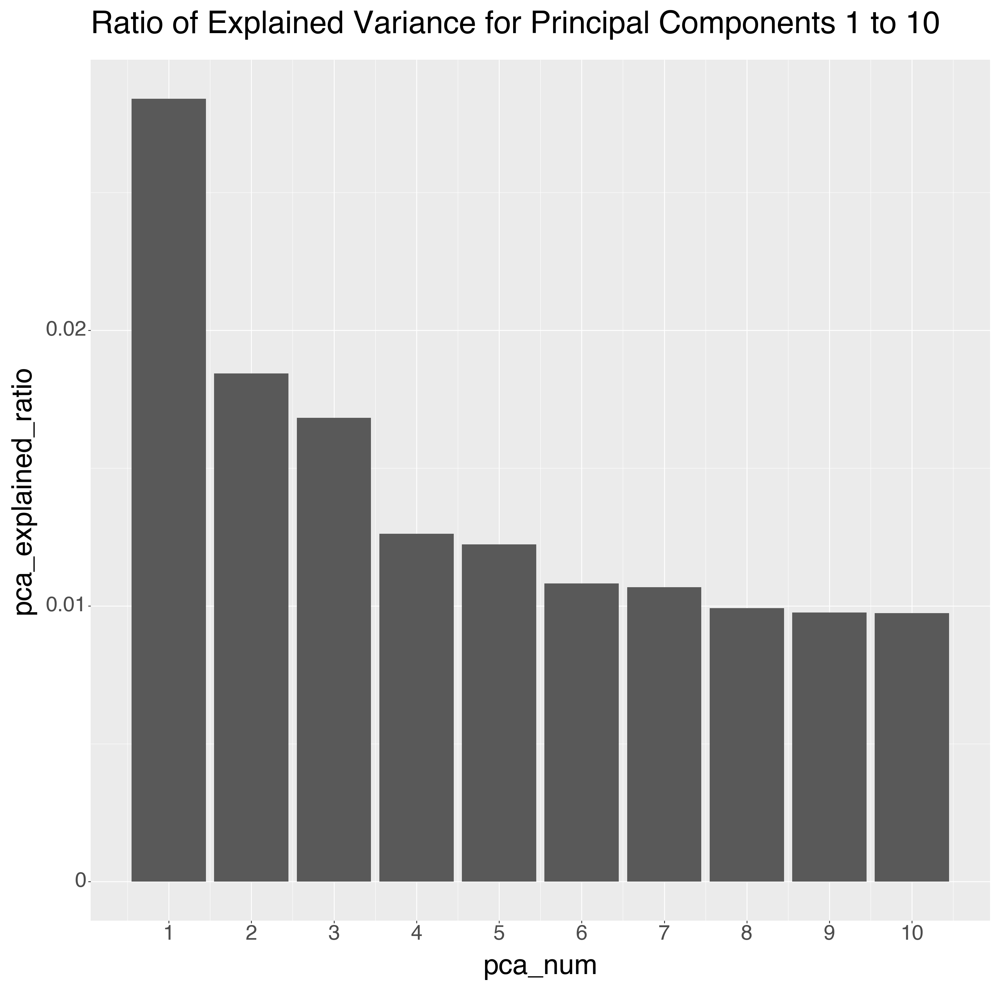

In [ ]:
global_pca_object_plot(loaded_global_clu_pca_obj, TaskType.CLUSTERING)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/nomic_pca_plots_dump/global_cla_pca_components_plot.png


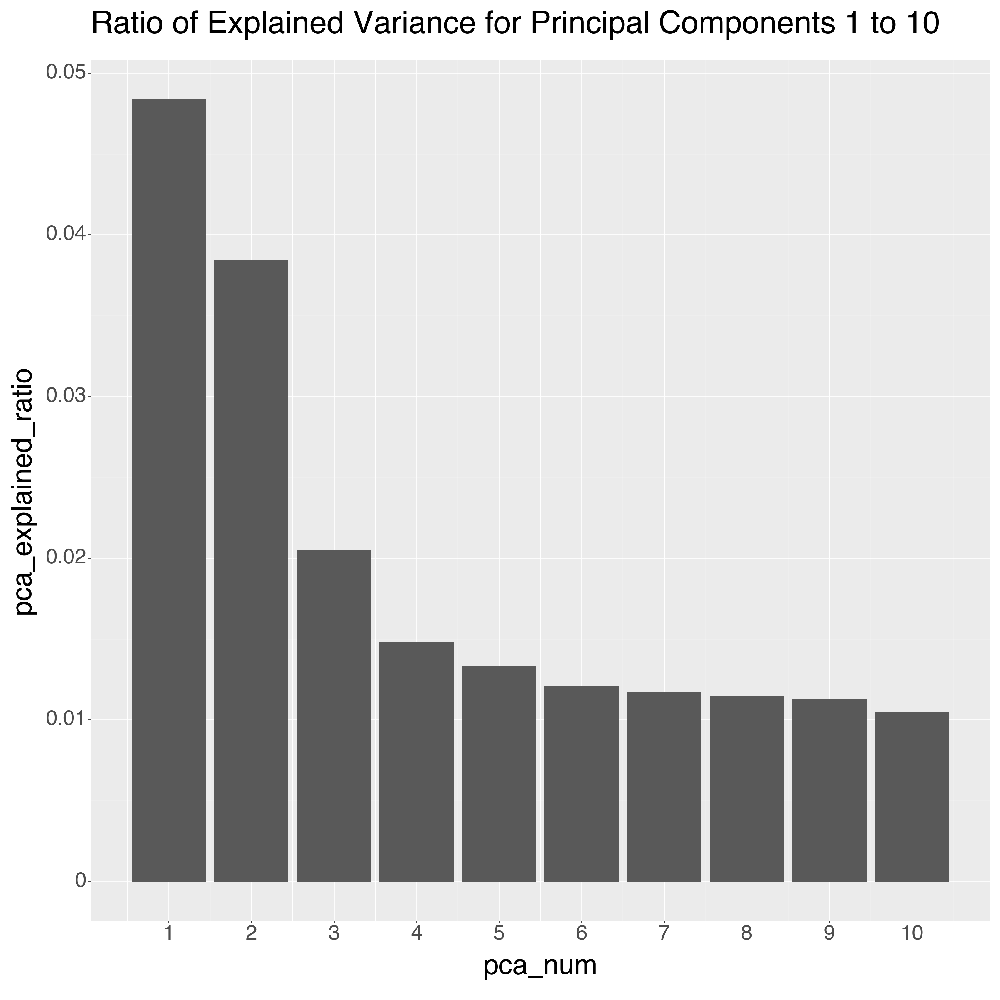

In [ ]:
global_pca_object_plot(loaded_global_cla_pca_obj, TaskType.CLASSIFICATION)

### Export Plots Dump

In [ ]:
nomic_pca_plots_dump_file_path = '/content/current_data_dump/nomic_pca_plots_dump'
nomic_pca_plots_dump_file_path_zip = '/content/current_data_dump/nomic_pca_plots_dump/nomic_pca_plots_dump'
shutil.make_archive(nomic_pca_plots_dump_file_path_zip, 'zip', nomic_pca_plots_dump_file_path)
print(f"Zip file created at: {nomic_pca_plots_dump_file_path_zip}")
result = subprocess.run([f"osf -p sakjg upload --force {nomic_pca_plots_dump_file_path_zip}.zip nomic_pca_plots_dump.zip"], shell=True, capture_output=True, text=True)
print(result.stderr)
print(f"File: {nomic_pca_plots_dump_file_path_zip} uploaded at osfstorage")